# Arches Cultural Heritage Partners' hackathon 2024 <img src="https://raw.githubusercontent.com/achp-project/cultural-heritage/main/www/logo.png" width="60px">
> ACHP hackathon 2024, 📅 28 August 2024, 17h00-18h00 (UK time). In person 📍Seminar Room, Institute of Archaeology, 36 Beaumont St and on [Teams](https://teams.microsoft.com/l/meetup-join/19%3ameeting_ZTYyNTJmMDEtMWJmMC00NDk2LWJkMGQtMzgwZWI5Y2FlODgy%40thread.v2/0?context=%7b%22Tid%22%3a%22cc95de1b-97f5-4f93-b4ba-fe68b852cf91%22%2c%22Oid%22%3a%229dce33a8-66a7-403f-a2c6-95948cb855d0%22%7d), University of Oxford, United Kingdom.

In [ ]:
# @title
%%capture captured_output
!pip install requests zipfile36 pandas geopandas tabulate shapely folium owslib sickle graphviz wget

# ACHP
!rm /content/cultural-heritage -R
!git clone --quiet https://github.com/achp-project/cultural-heritage.git
# !pip install  -q -r cultural-heritage/graph-parser/requirements.txt
%cd /content/cultural-heritage/graph-parser/
import graph_mixer as gm

# EAMENA
!rm /content/eamena-functions -R
%cd /content/
!git clone --quiet https://github.com/eamena-project/eamena-functions.git
%cd /content/eamena-functions/zenodo
import zenodo as zn

import folium
from owslib.wms import WebMapService
from shapely.geometry import shape
import json
import requests
import pandas as pd
import geopandas as gpd
import zipfile
import io
from xml.etree import ElementTree as ET
from tabulate import tabulate
import sickle
from sickle import Sickle
from IPython.display import display, HTML, IFrame, Markdown
from IPython.display import Image
import graphviz
from branca.element import Figure

## Arches/Cultural Heritage Management

In [ ]:
# @title

IFrame('https://CAA-France.github.io/website/diagrams/oarch_repo_user.html', width=1200, height=800)
# 'https://zoometh.github.io/openarchaeo-collaboration/analysis/data/derived_data/oarch_repo_user.html'

Graph of open archaeological GitHub repositories and connected users via contributions. Darker edges indicate a higher number of contributions. The color of the nodes indicates membership in the largest groups according to the method of edge betweenness without isolated nodes. Adapted from <a href="https://github.com/zackbatist/openarchaeo-collaboration" data-type="link" data-id="openarchaeo-collaboration" target="_blank" rel="noreferrer noopener">openarchaeo-collaboration</a>, published by Batist, Z.; Roe, J., 2024. Open archaeology, open source? Collaborative practices in an emerging community of archaeological software engineers. <em>Internet Archaeology</em> 67. <a href="https://doi.org/10.11141/ia.67.13" data-type="link" data-id="10.11141/ia.67.13" target="_blank" rel="noreferrer noopener">10.11141/ia.67.13</a>

## ACHP organisation

In [ ]:
# @title
gm.projects_extent()

> see the [ACHP presentation](https://colab.research.google.com/github/achp-project/cultural-heritage/blob/main/talks/2023-bhdc/rm_compar.ipynb) during the *Big Historical Data Conference*, 2023.

<img src="https://raw.githubusercontent.com/achp-project/cultural-heritage/main/talks/2024-hackathon/image-1.png" width="1000px">

## Our projects


#### MAHSA

In [ ]:
#@title

import folium
import requests
import pandas as pd
from IPython.display import IFrame

# URL of the raw GeoJSON file on GitHub
geojson_data = 'https://raw.githubusercontent.com/MAHSA-Project/arches-hackathon/main/MAHSA_AOI.geojson'
geojson_data_layer2 = 'https://raw.githubusercontent.com/MAHSA-Project/arches-hackathon/main/indus_river_basin.geojson'

# Fetch the GeoJSON data from GitHub
response = requests.get(geojson_data)
geojson_data = response.json()

response2 = requests.get(geojson_data_layer2)
geojson_data_2 = response2.json()

# Create a folium map centered on a specific location (you can customize the coordinates)
m = folium.Map(location=[29.57198352, 73.56025114], zoom_start=5)

# Define layer style
def style_function(feature):
    return {
        'fillColor': '#FF0000',
        'color': 'red',
        'weight': 2,
        'fillOpacity': 0.5
    }

def style_function2(feature):
    return {
        'fillColor': '#0000ff',
        'color': 'blue',
        'weight': 2,
        'fillOpacity': 0.5
    }

# Add the GeoJSON data to the map
folium.GeoJson(
    geojson_data,
    style_function=style_function,
    name="GeoJSON"
).add_to(m)

folium.GeoJson(
    geojson_data_layer2,
    style_function=style_function2,
    name="Category B"
).add_to(m)

legend_html = """
<div style="position: fixed;
            bottom: 50px; left: 50px; width: 250px; height: 80x;
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white; opacity: 0.8;
            padding: 10px;">
    <b>Legend</b><br>
    <i style="background: #0000ff; width: 18px; height: 18px; float: left; margin-right: 8px;"></i>Extended Indus River Basin<br>
    <i style="background: #FF0000; width: 18px; height: 18px; float: left; margin-right: 8px;"></i>MAHSA Area of Interest<br>
</div>
"""
m.get_root().html.add_child(folium.Element(legend_html))
# Add a layer control panel to the map
folium.LayerControl().add_to(m)

# Display the map
m

In [ ]:
#@title

# Create a dictionary for the data
data = {
    "Resource Model": ["Heritage Location", "Heritage Area", "Activity", "Person/Organisation", "Information Resource", "Historic Maps"],
    "Definition": ["To record archaeological sites, heritage buildings or any features within a site/place",
                 "To record group of archaeological/cultural heritage sites spread over an area",
                 "To record activites e.g. ground surveys related to heritage location and heritage area resource models",
                 "To record individuals and organisations", "To records sources of information e.g. publications, imagery etc.",
                 "To record information of historic maps"]
}

# Create a DataFrame
pd.set_option('display.max_colwidth', 0)
df = pd.DataFrame(data)
#df.style.set_properties(**{'text-align': 'center'})
# Display the DataFrame as a table
df

,Resource Model,Definition
0,Heritage Location,"To record archaeological sites, heritage buildings or any features within a site/place"
1,Heritage Area,To record group of archaeological/cultural heritage sites spread over an area
2,Activity,To record activites e.g. ground surveys related to heritage location and heritage area resource models
3,Person/Organisation,To record individuals and organisations
4,Information Resource,"To records sources of information e.g. publications, imagery etc."
5,Historic Maps,To record information of historic maps


In [ ]:
#@title

geojson_url = 'https://raw.githubusercontent.com/MAHSA-Project/arches-hackathon/main/maps_coverage.geojson'

response = requests.get(geojson_url)
geojson_data = response.json()

def style_function(feature):
    status = feature['properties']['status']
    if status == 0:
        return {
            'fillColor': '#ff0000',
            'color': 'black',
            'weight': 0.5,
            'fillOpacity': 0
        }
    elif status == 1:
        return {
            'fillColor': '#ffa500',
            'color': 'black',
            'weight': 1,
            'fillOpacity': 0.7
        }
    elif status == 2:
        return {
            'fillColor': '#dede4e',
            'color': 'black',
            'weight': 1,
            'fillOpacity': 0.7
        }
    elif status == 3:
        return {
            'fillColor': '#0000ff',
            'color': 'black',
            'weight': 1,
            'fillOpacity': 0.7
        }
    elif status == 4:
        return {
            'fillColor': '#0a6a25',
            'color': 'black',
            'weight': 1,
            'fillOpacity': 0.7
        }
    elif status == 5:
        return {
            'fillColor': '#f837e8',
            'color': 'black',
            'weight': 1,
            'fillOpacity': 0.7
        }
    else:
        return {
            'fillColor': '#0a6a25',
            'color': 'black',
            'weight': 1,
            'fillOpacity': 0.3
        }


m = folium.Map(location=[29.57198352, 73.56025114], zoom_start=5, width = '1100px', height = '800px')

folium.GeoJson(
    geojson_data,
    style_function=style_function,
    name="GeoJSON"
).add_to(m)

legend_html = """
<div style="position: fixed;
            bottom: 50px; left: 50px; width: 150px; height: 180px;
            border:2px solid grey; z-index:9999; font-size:14px;
            background-color:white; opacity: 0.8;
            padding: 10px;">
    <b>Legend</b><br>
    <i style="background: #ff0000; width: 18px; height: 18px; float: left; margin-right: 8px;"></i>Not Ordered<br>
    <i style="background: #ffa500; width: 18px; height: 18px; float: left; margin-right: 8px;"></i>Ordered<br>
    <i style="background: #dede4e; width: 18px; height: 18px; float: left; margin-right: 8px;"></i>Scanned<br>
    <i style="background: #0000ff; width: 18px; height: 18px; float: left; margin-right: 8px;"></i>In Progress<br>
    <i style="background: #0a6a25; width: 18px; height: 18px; float: left; margin-right: 8px;"></i>Georeferenced<br>
    <i style="background: #f837e8; width: 18px; height: 18px; float: left; margin-right: 8px;"></i>Missing<br>
</div>
"""

m.get_root().html.add_child(folium.Element(legend_html))

folium.LayerControl().add_to(m)

m

In [ ]:
#@title

# URL of the raw CSV file on GitHub
csv_url = 'https://raw.githubusercontent.com/MAHSA-Project/arches-hackathon/main/metadata_sample.csv'

# Load the CSV file into a DataFrame
df = pd.read_csv(csv_url,encoding='UTF-8')

# Display the DataFrame as a table
df

,Title,Repository,Collection Area,Project / Collection,Level,Reference,Full Shelfmarks,Title Type,Date range,Start date,...,Logical type,Logical label,Page sequence range,Page label range,Material type,Item type,Survey Date Range,Map Number (first),Map Letter (secondary),Map Number (tertiary)
0,Baluchistah Sind No.39 H 3,Cambridge University Library,Map Department,India Office Records,File,PR-MAPS-00360-00001,PR-MAPS-00360-00001-00039-H-00003-01946-000-00001,Formal title,1946,1946,...,Map,Map,1,1,Archives and Manuscripts,ArchiveDescription,"1892-1893, 1897-1898, 1900-1901",39,H,3
1,Sind No. 39 H 4,Cambridge University Library,Map Department,India Office Records,File,PR-MAPS-00360-00001,PR-MAPS-00360-00001-00039-H-00004-01946-000-00001,Formal title,1946,1946,...,Map,Map,1,1,Archives and Manuscripts,ArchiveDescription,"1892-1893,1900-1901, 1902-1903",39,H,4
2,Punjab No.39 J 11,Cambridge University Library,Map Department,India Office Records,File,PR-MAPS-00360-00001,PR-MAPS-00360-00001-00039-J-00011-01909-000-00001,Formal title,1909,1909,...,Map,Map,1,1,Archives and Manuscripts,ArchiveDescription,1907-1908,39,J,11
3,Punjab No.39 J 15,Cambridge University Library,Map Department,India Office Records,File,PR-MAPS-00360-00001,PR-MAPS-00360-00001-00039-J-00015-01908-000-00001,Formal title,1908,1908,...,Map,Map,1,1,Archives and Manuscripts,ArchiveDescription,1907-1908,39,J,15
4,Punjab No.39 J 12,Cambridge University Library,Map Department,India Office Records,File,PR-MAPS-00360-00001,PR-MAPS-00360-00001-00039-J-00012-01909-000-00001,Formal title,1909,1909,...,Map,Map,1,1,Archives and Manuscripts,ArchiveDescription,1907-1908,39,J,12
5,Punjab No.39 J 10,Cambridge University Library,Map Department,India Office Records,File,PR-MAPS-00360-00001,PR-MAPS-00360-00001-00039-J-00010-01909-000-00001,Formal title,1909,1909,...,Map,Map,1,1,Archives and Manuscripts,ArchiveDescription,1907-1908,39,J,10
6,Punjab No.39 K 01,Cambridge University Library,Map Department,India Office Records,File,PR-MAPS-00360-00001,PR-MAPS-00360-00001-00039-K-00001-01909-000-00001,Formal title,1909,1909,...,Map,Map,1,1,Archives and Manuscripts,ArchiveDescription,1906-1907,39,K,1
7,Punjab No.39 K 02,Cambridge University Library,Map Department,India Office Records,File,PR-MAPS-00360-00001,PR-MAPS-00360-00001-00039-K-00002-01924-000-00001,Formal title,1924,1924,...,Map,Map,1,1,Archives and Manuscripts,ArchiveDescription,1922-1923,39,K,2
8,Punjab No.39 K 03,Cambridge University Library,Map Department,India Office Records,File,PR-MAPS-00360-00001,PR-MAPS-00360-00001-00039-K-00003-01924-000-00001,Formal title,1924,1924,...,Map,Map,1,1,Archives and Manuscripts,ArchiveDescription,1922-1923,39,K,3
9,Punjab No.39 K 04,Cambridge University Library,Map Department,India Office Records,File,PR-MAPS-00360-00001,PR-MAPS-00360-00001-00039-K-00004-01924-000-00001,Formal title,1924,1924,...,Map,Map,1,1,Archives and Manuscripts,ArchiveDescription,1922-1923,39,K,4


### CAAL and MAEASaM

### EAMENA and MaREA


<br>
<p align="center">
  <img alt="img-name" src="https://raw.githubusercontent.com/eamena-project/eamena-arches-dev/main/dbs/database.eamena/data/business_data/grids_nb_hps.png" width="1400px">
  <br>
    383,575 heritages places in August 2024
</p>

#### Data lifecycle

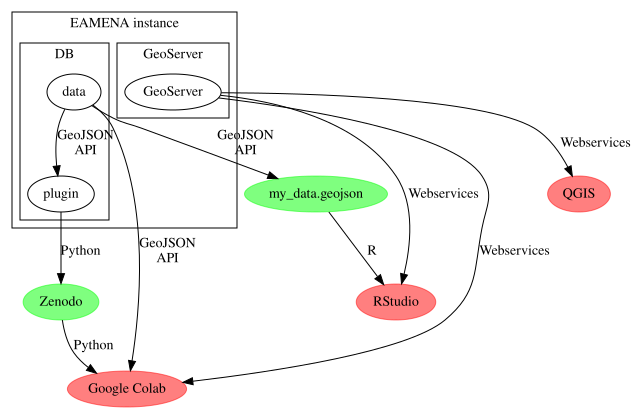

In [ ]:
# @title

dot = graphviz.Digraph(comment='Data lifecycle')

# Nodes defined individually with hyperlinks
dot.node('A', 'data', href='https://database.eamena.org/')
dot.node('B', 'RStudio', href='https://github.com/eamena-project/eamenaR', color='#FF000080', style='filled')
dot.node('C', 'Zenodo', href='https://zenodo.org/communities/eamena', color='#00FF0080', style='filled')
dot.node('D', 'plugin', href='https://database.eamena.org/citations/')
dot.node('E', 'Google Colab', href='https://python.org', color='#FF000080', style='filled')
dot.node('F', 'my_data.geojson', href='https://github.com/eamena-project/eamena-arches-dev/blob/main/projects/sistan/data/sample_2.geojson', color='#00FF0080', style='filled')
dot.node('G', 'GeoServer', href='https://geoserver.org/')
dot.node('H', 'QGIS', href='https://www.qgis.org/', color='#FF000080', style='filled')

# Edges between nodes
dot.edge('A', 'F', 'GeoJSON\nAPI')
dot.edge('F', 'B', 'R')
dot.edge('A', 'D', 'GeoJSON\nAPI')
dot.edge('A', 'E', 'GeoJSON\nAPI')
dot.edge('D', 'C', 'Python')
dot.edge('C', 'E', 'Python')
dot.edge('G', 'H', 'Webservices')
dot.edge('G', 'B', 'Webservices')
dot.edge('G', 'E', 'Webservices')

# Outer subgraph containing multiple nested subgraphs
with dot.subgraph(name='cluster_outer') as outer:
    outer.attr(label='EAMENA instance')

    # First nested subgraph
    with outer.subgraph(name='cluster_AD') as inner:
        inner.attr(label='DB')
        inner.node('A')
        inner.node('D')

    # Second nested subgraph
    with outer.subgraph(name='cluster_XY') as inner:
        inner.attr(label='GeoServer')
        inner.node('G')

dot.render('flowchart', view=True)
dot

#### Reference data

##### Mapping the Middle East and North Africa region

In [ ]:
# @title

def style_function(feature):
    return {
        'color': '#000000',
        'weight': 0.2,
        'fillOpacity': 0
    }

# contour
geojson_data = zn.zenodo_read(file_url="https://zenodo.org/records/13329575/files/EAMENA_Grid_contour.geojson?download=1", verbose=False)
multipart_geometry = geojson_data.unary_union
centroid = multipart_geometry.centroid
m = folium.Map(location=[centroid.y, centroid.x], zoom_start=3)
# m = folium.Map(location=[29, 25], zoom_start=3) # TODO: calculate the centroid on the fly
folium.GeoJson(geojson_data, name='contour', style_function = style_function).add_to(m)

# GS
geojson_data = zn.zenodo_read(file_url="https://zenodo.org/records/13329575/files/EAMENA_Grid.geojson?download=1", verbose=False)
geojson_layer = folium.GeoJson(geojson_data, name='grids', style_function = style_function).add_to(m)
folium.features.GeoJsonPopup(fields=['gs'], aliases=['GS'],
                              labels=True, max_width=500, min_width=10).add_to(geojson_layer)
geojson_layer.add_to(m)
folium.LayerControl().add_to(m)
fig = Figure(width=1100, height=500)
fig.add_child(m)
fig

<br>
<p align="center">
    27,585 Grid Squares
</p>

> see also: [EAMENA's grids](https://zenodo.org/records/13329575) and [collections, concepts and resource models](https://zenodo.org/records/10142707) hosted on Zenodo

##### Explain the reading grid

In [ ]:
# @title

IFrame('https://eamena-project.github.io/eamena-arches-dev/dbs/database.eamena/data/reference_data/rm/hp/mds/fields-description.html', width=1200, height=600)

> see the same figure on the [EAMENA's website](https://eamena.org/advanced-use#rm-hp-fields) and [GitHub](https://eamena-project.github.io/eamena-arches-dev/dbs/database.eamena/data/reference_data/rm/hp/mds/fields-description.html)

#### Business data

##### The *Sistan dataset* example

<img src="https://raw.githubusercontent.com/eamena-project/eamena-arches-dev/main/talks/2024-citation-generator/img/pub-joad-sistan-recut.png" width="500px">

https://openarchaeologydata.metajnl.com/articles/10.5334/joad.123

In [ ]:
# @title

# GS
geojson_data_gs = zn.zenodo_read(file_url="https://zenodo.org/records/10376132/files/sistan_part1_gs.zip?download=1", verbose=False)
# centroid, to center the map
multipart_geometry = geojson_data_gs.unary_union
centroid = multipart_geometry.centroid
m = folium.Map(location=[centroid.y, centroid.x], zoom_start=8)
folium.GeoJson(geojson_data_gs).add_to(m)

# HP
geojson_data_hp = zn.zenodo_read(file_url="https://zenodo.org/records/10375902/files/sistan_part1_hps.zip?download=1", verbose=False)
for _, row in geojson_data_hp.iterrows():
    centroid = row.geometry.centroid
    popup_text = f"ID: {row['EAMENA ID']}"  # Construct the popup text using the EAMENA ID field
    popup = folium.Popup(popup_text, max_width=250)  # Create a Popup object
    folium.CircleMarker(
        location=(centroid.y, centroid.x),
        color='black',
        radius=1,
        popup=popup  # Add the Popup object to the CircleMarker
    ).add_to(m)

fig = Figure(width=1100, height=500)
fig.add_child(m)
fig

In [ ]:
# @title

# geojson_data = zn.zenodo_read(file_url="https://zenodo.org/records/10375902/files/sistan_part1_hps.zip?download=1", verbose=False)
geojson_data_hp[['EAMENA ID', 'Heritage Place Function', 'Country Type', 'Threat Category', 'Threat Cause Type', 'Overall Condition State Type', 'Assessment Investigator - Actor']].sample(5)

,EAMENA ID,Heritage Place Function,Country Type,Threat Category,Threat Cause Type,Overall Condition State Type,Assessment Investigator - Actor
950,EAMENA-0238300,Unknown,Afghanistan,Natural,Water and/or Wind Action,Destroyed,Bijan Rouhani
882,EAMENA-0239653,Unknown,Afghanistan,Natural,Water and/or Wind Action,Very Bad,Bijan Rouhani
1286,EAMENA-0238857,Defensive/Fortification,Afghanistan,"Natural, Natural, Natural","Water and/or Wind Action, Precipitation, Drought",Destroyed,"Danlei Zhou, Bijan Rouhani"
601,EAMENA-0207188,Unknown,Iran (Islamic Republic of),"Natural, Natural, Management and Institutional...","Water and/or Wind Action, Precipitation, Lack ...",Destroyed,Bijan Rouhani
513,EAMENA-0192701,Domestic,Iran (Islamic Republic of),"Natural, Natural, Natural","Water and/or Wind Action, Precipitation, Flooding",Destroyed,Bijan Rouhani


##### The *Atlas Archéologique d'Algérie* example



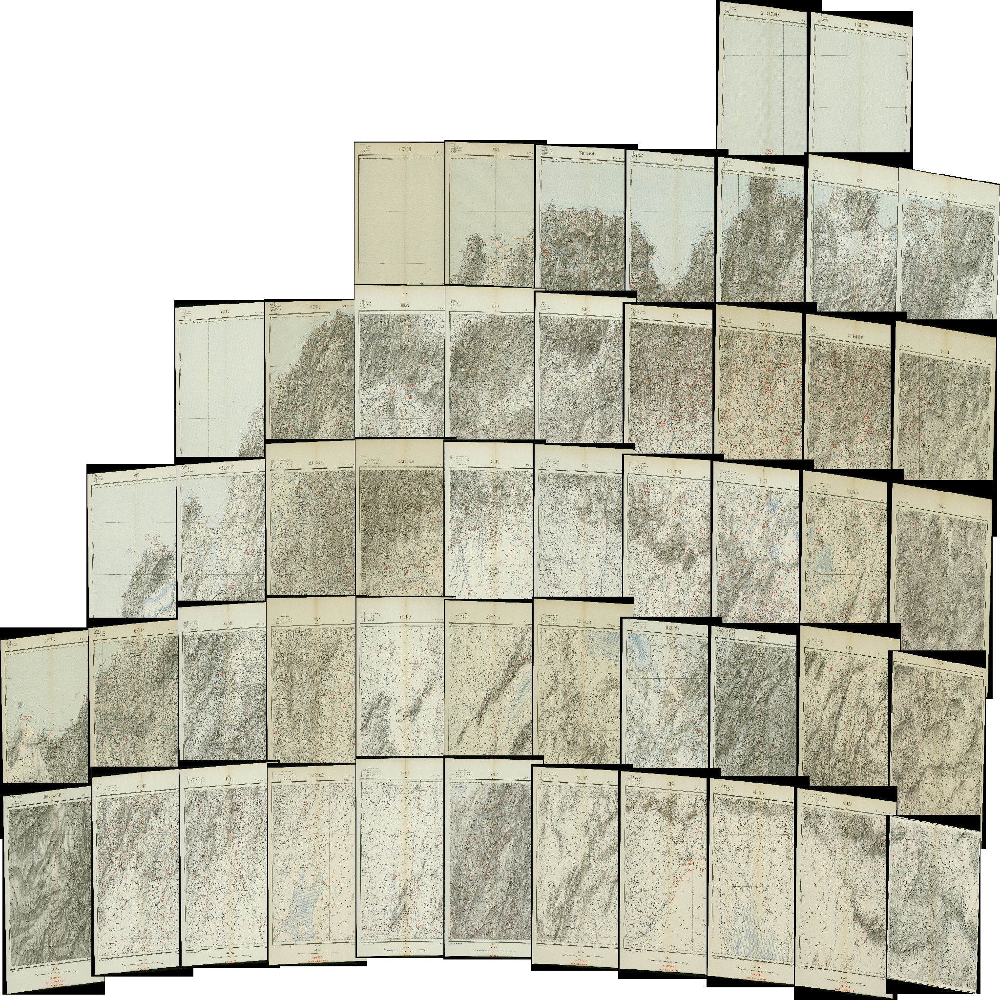

In [ ]:
# @title


# GeoServer
wms_url = "http://54.155.109.226:8080/geoserver/ows?"; layer_name = "AAA"
wms = WebMapService(wms_url)
bbox = wms[layer_name].boundingBoxWGS84
response = wms.getmap(
    layers=[layer_name],
    bbox=bbox,  # Use the bounding box from WMS layer directly
    format="image/png",
    size=(2048, 2048),
    # size=(1024, 1024), # lighter
    crs="EPSG:4326",
    transparent=True,
)

def save_layer_as_image(layer, filename):
    with open(filename, 'wb') as out:
        out.write(layer.read())

save_layer_as_image(response, 'test.png')

m = folium.Map(width='100%', height='100%', location=[(bbox[1]+bbox[3])/2, (bbox[0]+bbox[2])/2], control_scale=True, zoom_start=6)
image_overlay = folium.raster_layers.ImageOverlay(
    name='Atlas Archéologique d\'Algérie',
    image='test.png',
    bounds=[[bbox[1], bbox[0]], [bbox[3], bbox[2]]],  # [miny, minx], [maxy, maxx]
    transparent=True,
    interactive=True,
    cross_origin=False,
    format="image/png",
    zindex=1,
).add_to(m)

# GS
url = 'https://raw.githubusercontent.com/eamena-project/eamena-arches-dev/main/projects/aaa/gs_mbr.geojson'
response = requests.get(url)
geojson_data_gs = response.json()
folium.GeoJson(geojson_data_gs, name='grids').add_to(m)

folium.LayerControl().add_to(m)
fig = Figure(width=1100, height=500)
fig.add_child(m)
fig

> see also [EAMENA DB diagram](https://github.com/eamena-project/eamena-arches-dev/tree/main/dbs/database.eamena) on GitHub

## FAInteroperableR policies and the 'hackathon'

#### IT

ACHP and Arches based on mature and state-of-art technologies


| IT | Description |
|----------|----------|
| PostgreSQL<br><img src='https://raw.githubusercontent.com/zoometh/thomashuet/master/img/app-bd-postgres-1.png' width = "70px"> | PostgreSQL database |
| JSON<br><img src='https://raw.githubusercontent.com/zoometh/thomashuet/master/img/app-prg-js-format-json.png' width = "40px"> | Data objects based on, or extending, JSON (JSON-LD, GeoJSON, PostgreSQL JSONB type) |
| Python<br><img src='https://raw.githubusercontent.com/zoometh/thomashuet/master/img/app-prg-python-2.png' width = "30px"> | Logics based on Python |
| GitHub<br><img src='https://raw.githubusercontent.com/zoometh/thomashuet/master/img/app-github.png' width = "30px"> | Host published business data, reference data and metadata on GitHub |


#### Collective approach

<img src="https://raw.githubusercontent.com/achp-project/cultural-heritage/main/talks/2024-hackathon/img/PXL_20240828_111607341.jpg" width="600px">

<img src="https://raw.githubusercontent.com/achp-project/cultural-heritage/main/talks/2024-hackathon/image-2.png" width="1200px">